# SemanticDraw Region-Based Semantic Control Demo (Arbitrary Scale)


## Preparation

In [2]:
seed = 2023
device = 0

In [3]:
import sys
import time
import warnings

sys.path.append('../src')
warnings.filterwarnings('ignore')

import torch
import torchvision.transforms as T
from PIL import Image
from diffusers.utils import make_image_grid
from functools import reduce

from util import seed_everything, blend
from model import SemanticDrawPipeline
from ipython_util import dispt


seed_everything(seed)
device = f'cuda:{device}'
print(f'[INFO] Initialized with seed  : {seed}')
print(f'[INFO] Initialized with device: {device}')

[INFO] Initialized with seed  : 2023
[INFO] Initialized with device: cuda:0


## Target artwork

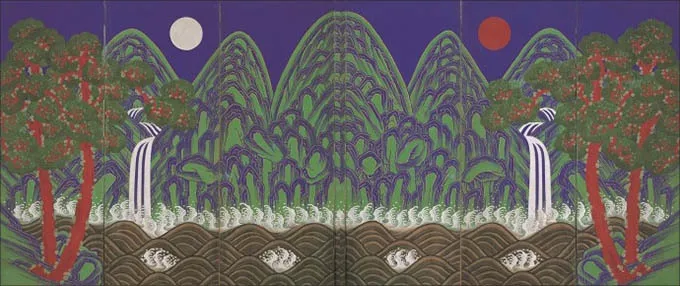

In [4]:
Image.open('../assets/irworobongdo/irworobongdo.webp')

# Run

## Step 1: Load a SemanticDraw pipeline.

In [5]:
smd = SemanticDrawPipeline(device)

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


[INFO] Loading Stable Diffusion...


Loading pipeline components...: 100%|██████████| 7/7 [00:00<00:00, 12.18it/s]


[INFO] Model is loaded!


## Step 2: Load *semantic palette*, i.e., prompts and masks.

[INFO] Loading masks...


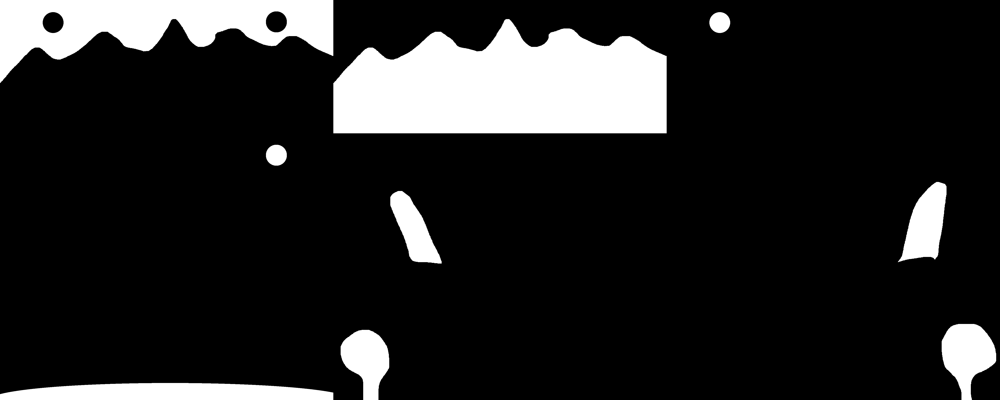

[INFO] Loading prompts...
Background Prompt: clear deep blue sky
Prompt1: summer mountains
Prompt2: the sun
Prompt3: the moon
Prompt4: a giant waterfall
Prompt5: a giant waterfall
Prompt6: clean deep blue lake
Prompt7: a large tree
Prompt8: a large tree


In [6]:
# Prepare masks.
print('[INFO] Loading masks...')

name = 'irworobongdo'
mask_all = Image.open(f'../assets/{name}/{name}_full.png').convert('RGBA')
masks = [Image.open(f'../assets/{name}/{name}_{i}.png').convert('RGBA') for i in range(1, 9)]
masks = [(T.ToTensor()(mask)[-1:] > 0.5).float() for mask in masks]
# Background is simply non-marked set of pixels.
background = reduce(torch.logical_and, [m == 0 for m in masks])
dispt([background] + masks, row=3)

masks = torch.stack([background] + masks, dim=0)
mask_strengths = 1.0
mask_stds = 0.0

# Prepare prompts.
print('[INFO] Loading prompts...')

prompts = [
    # Background prompt.
    'clear deep blue sky',
    # Foreground prompts.
    'summer mountains',
    'the sun',
    'the moon',
    'a giant waterfall',
    'a giant waterfall',
    'clean deep blue lake',
    'a large tree',
    'a large tree',
]
negative_prompt = 'worst quality, bad quality, normal quality, cropped, framed'
negative_prompts = [negative_prompt] * len(prompts)

for i, prompt in enumerate(prompts):
    print((f'Prompt{i}' if i > 0 else 'Background Prompt') + ': ' + prompt)

height, width = masks.shape[-2:]

## Step 3: Generate a large-scale image from multiple (9!) text prompts in a minute!

### Main generation routine

100%|██████████| 5/5 [00:40<00:00,  8.08s/it]


Elapsed Time: 45.07918834686279


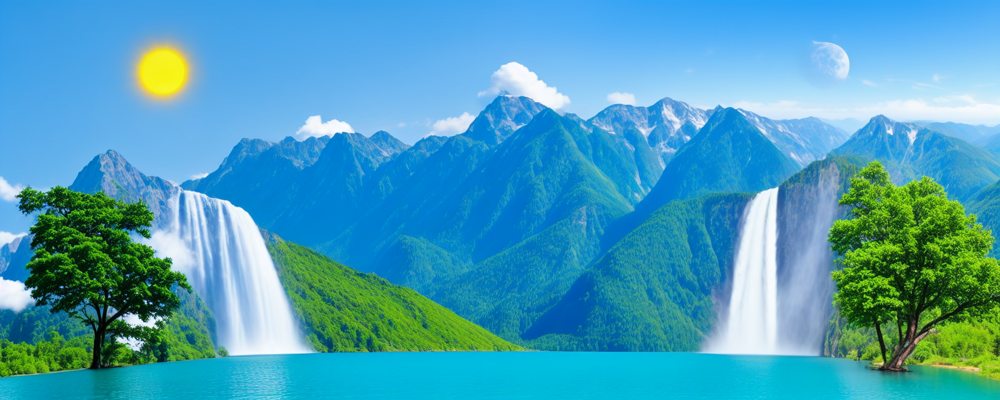

In [7]:
tic = time.time()
img = smd(
    prompts, negative_prompts, masks=masks.float(),
    mask_stds=mask_stds, mask_strengths=mask_strengths,
    height=height, width=width, tile_size=768, bootstrap_steps=2,
)
toc = time.time()
print(f'Elapsed Time: {toc - tic}')
display(img)

### Visualize mask fidelity

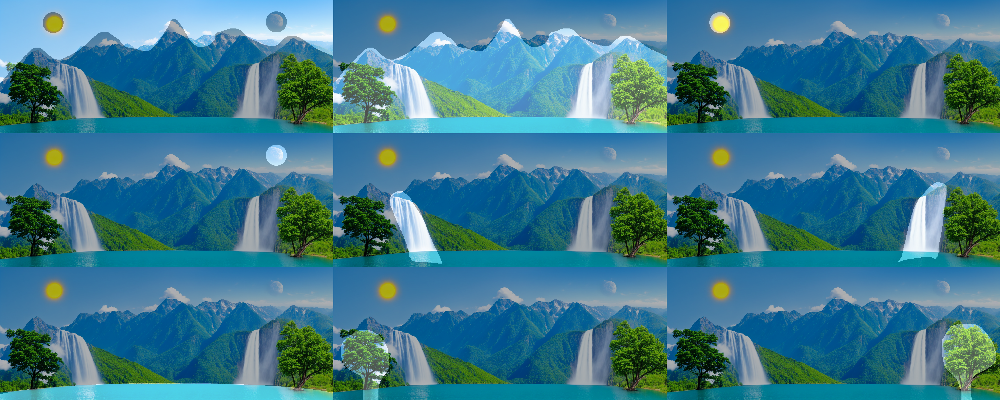

In [8]:
alpha = 0.3

im = T.ToTensor()(img)
blended = im[None] * (1 - alpha) + masks * alpha
dispt(blended, row=3)